In [122]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Hex Parachute Example

In [123]:
import numpy as np

import dismech

b = 0.02
h = 0.001

geom = dismech.GeomParams(rod_r0=1e-3,
                          shell_h=1e-3)

material = dismech.Material(density=1500,
                            youngs_rod=10e6,
                            youngs_shell=10e8,
                            poisson_rod=0.5,
                            poisson_shell=0.3)

dynamic_3d_sim = dismech.SimParams(static_sim=False,
                                   two_d_sim=False,
                                   use_mid_edge=False,
                                   use_line_search=False,
                                   show_floor=False,
                                   log_data=True,
                                   log_step=1,
                                   dt=5e-3,
                                   max_iter=25,
                                   total_time=3.0,
                                   plot_step=10,
                                   tol=1e-4,
                                   ftol=1e-4,
                                   dtol=1e-2)

env = dismech.Environment()
env.add_force('gravity', g=np.array([0.0, 0.0, -9.81]))
env.add_force('aerodynamics', rho=1, cd=10)

geo = dismech.Geometry.from_txt(
    'tests/resources/parachute/hexparachute_n6_python.txt')

robot = dismech.SoftRobot(geom, material, geo, dynamic_3d_sim, env)

In [124]:
from tqdm.notebook import tqdm

fixed_points = np.array([])

stepper = dismech.TimeStepper(robot, fixed_points)
robot = stepper.robot   # update robot

# Manually set rod_shell and rod_rod_joints to EI = 0 GJ = 0
indices = np.concat((np.arange(0,15), np.arange(75,81), np.arange(88,100), np.arange(116,128), np.arange(135,141)))
for i in indices:
    robot.bend_twist_springs[i].stiff_EI = np.array([0,0])
    robot.bend_twist_springs[i].stiff_GJ = 0

robot.scale_mass_matrix(0, 100)  # weigh down parachute

qs = []
steps = int(robot.sim_params.total_time / robot.sim_params.dt) + 1
for i in tqdm(range(1, steps)):
    new_robot = stepper.step()
    qs.append(new_robot.q)
qs = np.stack(qs)

  0%|          | 0/600 [00:00<?, ?it/s]

In [125]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d.art3d import Line3DCollection, Poly3DCollection

# Define options (you can set any of these attributes)
from dataclasses import dataclass

@dataclass
class Options:
    free_node_color: str = 'blue'
    fixed_node_color: str = 'red'
    edge_color: str = 'black'
    face_color: tuple = (0.5, 0.5, 0.5, 0.3)
    title: str = "Dismech Simulation"
    x_lim: tuple = None
    y_lim: tuple = None
    z_lim: tuple = None
    camera_view: tuple = (30, 45)  # (elevation, azimuth) angles in degrees
    follow_data: bool = False  # New option to follow the data dynamically

def get_animation(robot, t, qs, options: Options):
    n_frames = qs.shape[0]
    n_nodes = len(robot.node_dof_indices)

    # Precompute mapping from node index to its dof indices.
    node_dof_list = [robot.map_node_to_dof(i) for i in range(n_nodes)]

    # Pre-compute node positions for each frame; shape (n_frames, n_nodes, 3)
    nodes_all = np.array([[q[dofs] for dofs in node_dof_list] for q in qs])

    # Determine which nodes are fixed
    fixed_set = set(robot.fixed_dof)
    node_is_fixed = np.array([all(d in fixed_set for d in dofs) for dofs in node_dof_list])

    # Create figure and 3D axis.
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    ax.set_xlabel('X Position')
    ax.set_ylabel('Y Position')
    ax.set_zlabel('Z Position')
    ax.set_title(options.title)

    ax.view_init(*options.camera_view)

    scatter_free = ax.scatter([], [], [], color=options.free_node_color, s=30)
    scatter_fixed = ax.scatter([], [], [], color=options.fixed_node_color, s=30)

    edge_collection = Line3DCollection([[(0, 0, 0), (0, 0, 0)]], colors=options.edge_color, linewidths=1.5)
    ax.add_collection3d(edge_collection)
    face_collection = Poly3DCollection([[(0, 0, 0), (0, 0, 0), (0, 0, 0)]], facecolors=options.face_color, edgecolors='none')
    ax.add_collection3d(face_collection)

    time_text = ax.text2D(0.05, 0.95, "", transform=ax.transAxes)

    if not options.follow_data:
        ax.set_xlim(*((options.x_lim or (nodes_all[:, :, 0].min(), nodes_all[:, :, 0].max()))))
        ax.set_ylim(*((options.y_lim or (nodes_all[:, :, 1].min(), nodes_all[:, :, 1].max()))))
        ax.set_zlim(*((options.z_lim or (nodes_all[:, :, 2].min(), nodes_all[:, :, 2].max()))))

    def init():
        scatter_free._offsets3d = ([], [], [])
        scatter_fixed._offsets3d = ([], [], [])
        edge_collection.set_segments([])
        face_collection.set_verts([])
        time_text.set_text("")
        return scatter_free, scatter_fixed, edge_collection, face_collection, time_text

    def update(frame):
        nodes = nodes_all[frame]
        scatter_free._offsets3d = (nodes[~node_is_fixed, 0], nodes[~node_is_fixed, 1], nodes[~node_is_fixed, 2])
        scatter_fixed._offsets3d = (nodes[node_is_fixed, 0], nodes[node_is_fixed, 1], nodes[node_is_fixed, 2])

        edge_collection.set_segments([[nodes[i], nodes[j]] for i, j in robot.edges])
        face_collection.set_verts([[nodes[i], nodes[j], nodes[k]] for i, j, k in robot.face_nodes_shell])

        if options.follow_data:
            ax.set_xlim(nodes[:, 0].min(), nodes[:, 0].max())
            ax.set_ylim(nodes[:, 1].min(), nodes[:, 1].max())
            ax.set_zlim(nodes[:, 2].min(), nodes[:, 2].max())

        time_text.set_text(f"Time: {t[frame]:.2f}s (Step: {frame+1}/{n_frames})")
        return scatter_free, scatter_fixed, edge_collection, face_collection, time_text

    ani = FuncAnimation(fig, update, frames=n_frames, init_func=init, interval=50, blit=False)
    return ani


In [129]:
%matplotlib notebook
from IPython.display import HTML
t = np.arange(robot.sim_params.total_time, step=robot.sim_params.dt)  # (100)
options = Options(title='Hex Parachute (N=6)',
                  camera_view=(20,0),
                  follow_data=True)

# Get the animation
ani = get_animation(robot, t[:600:3], qs[:600:3], options)
#ani.save('hex_parachute.gif', 'pillow')
HTML(ani.to_jshtml())

<IPython.core.display.Javascript object>

Animation size has reached 21033660 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [130]:
ani.save('hex_parachute.gif', 'pillow')

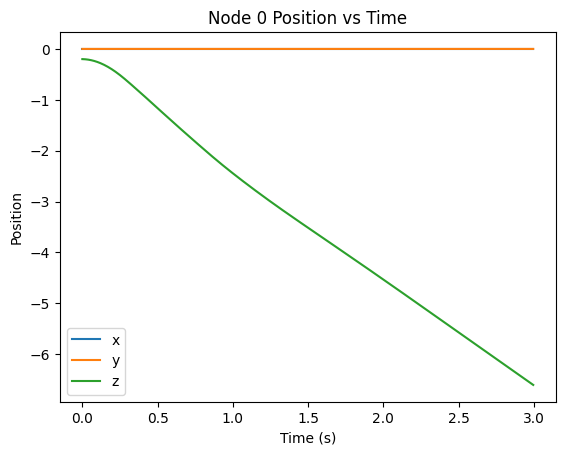

[ 2.67028721e-05  5.70135781e-05 -6.60572355e+00]


In [128]:
%matplotlib inline
log_node_index = 0

node_pos = qs[:,robot.map_node_to_dof(log_node_index)]
plt.plot(t, node_pos, label=['x','y','z'])
plt.title("Node {} Position vs Time".format(log_node_index))
plt.xlabel("Time (s)")
plt.ylabel("Position")
plt.legend()
plt.show()
print(node_pos[-1])